# Chapter 2 - Ex1: Gemstone - cubic_zirconia - Price Prediction
## EDA & Data preprocessing

In [ ]:
import pandas as pd
import numpy as np
import dataprep
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
data = pd.read_csv("Gemstone/cubic_zirconia.csv", index_col=0)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26967 entries, 1 to 26967
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    26967 non-null  float64
 1   cut      26967 non-null  object 
 2   color    26967 non-null  object 
 3   clarity  26967 non-null  object 
 4   depth    26270 non-null  float64
 5   table    26967 non-null  float64
 6   x        26967 non-null  float64
 7   y        26967 non-null  float64
 8   z        26967 non-null  float64
 9   price    26967 non-null  int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 2.3+ MB


In [ ]:
data.head()

,carat,cut,color,clarity,depth,table,x,y,z,price
1,0.30,Ideal,E,SI1,62.1,58.0,4.27,4.29,2.66,499
2,0.33,Premium,G,IF,60.8,58.0,4.42,4.46,2.70,984
3,0.90,Very Good,E,VVS2,62.2,60.0,6.04,6.12,3.78,6289
4,0.42,Ideal,F,VS1,61.6,56.0,4.82,4.80,2.96,1082
5,0.31,Ideal,F,VVS1,60.4,59.0,4.35,4.43,2.65,779


In [ ]:
data.describe()

,carat,depth,table,x,y,z,price
count,26967.000000,26270.000000,26967.000000,26967.000000,26967.000000,26967.000000,26967.000000
mean,0.798375,61.745147,57.456080,5.729854,5.733569,3.538057,3939.518115
std,0.477745,1.412860,2.232068,1.128516,1.166058,0.720624,4024.864666
min,0.200000,50.800000,49.000000,0.000000,0.000000,0.000000,326.000000
25%,0.400000,61.000000,56.000000,4.710000,4.710000,2.900000,945.000000
50%,0.700000,61.800000,57.000000,5.690000,5.710000,3.520000,2375.000000
75%,1.050000,62.500000,59.000000,6.550000,6.540000,4.040000,5360.000000
max,4.500000,73.600000,79.000000,10.230000,58.900000,31.800000,18818.000000


In [ ]:
# EDA
from dataprep.eda import create_report, plot

In [ ]:
# REPORT of DATA
report = create_report(data)

  0%|                                                          | 0/1648 [00:00<?, ?it/s]

c:\program files\python38\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\program files\python38\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
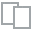
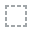
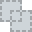
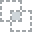
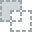
...
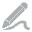
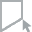
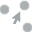
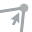
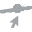

In [ ]:
report

  0%|                                                           | 0/517 [00:00<?, ?it/s]


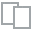
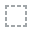
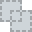
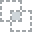
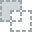
...
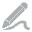
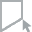
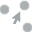
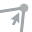
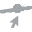

In [ ]:
# ANALYZE A DATAFRAME
plot(data)

In [ ]:
# Quan sát kết quả cho thấy:
# Dữ liệu chỉ bị thiếu ở cột depth (~ 2.58%)
# Xem xét mối quan hệ giữa price và depth sau khi đã drop bỏ các dòng trống của depth
data_price_depth = data[["price", "depth"]].dropna()

In [ ]:
data_price_depth.corr()

,price,depth
price,1.000000,-0.002569
depth,-0.002569,1.000000


In [ ]:
# Mối quan hệ giữa price và depth rất nhỏ -> không cần đưa depth vào khi dự đoán price

In [ ]:
# Mối quan hệ giữa các biến liên tục
data.dropna().corr()

,carat,depth,table,x,y,z,price
carat,1.000000,0.035364,0.181771,0.976298,0.940101,0.969338,0.922134
depth,0.035364,1.000000,-0.298011,-0.018715,-0.024735,0.101624,-0.002569
table,0.181771,-0.298011,1.000000,0.196156,0.182176,0.155429,0.126587
x,0.976298,-0.018715,0.196156,1.000000,0.961753,0.985748,0.885990
y,0.940101,-0.024735,0.182176,0.961753,1.000000,0.956434,0.855165
z,0.969338,0.101624,0.155429,0.985748,0.956434,1.000000,0.876229
price,0.922134,-0.002569,0.126587,0.885990,0.855165,0.876229,1.000000


C:\Users\ktphuong\AppData\Local\Temp\ipykernel_16400\240934219.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.dropna().corr(), annot=True, cmap='coolwarm', center=0)


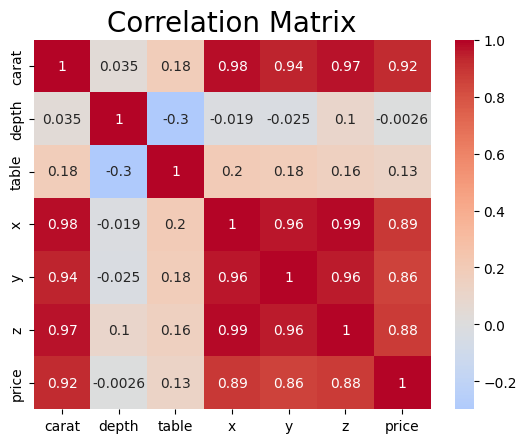

In [ ]:
# Plotting the correlation matrix
# plt.figure(figsize=(10, 8))
sns.heatmap(data.dropna().corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=20)
plt.show()

In [ ]:
# Theo corr thì chúng ta có thể không cần đưa depth và table vào khi dự đoán

In [ ]:
data["price"].describe()

count    26967.000000
mean      3939.518115
std       4024.864666
min        326.000000
25%        945.000000
50%       2375.000000
75%       5360.000000
max      18818.000000
Name: price, dtype: float64

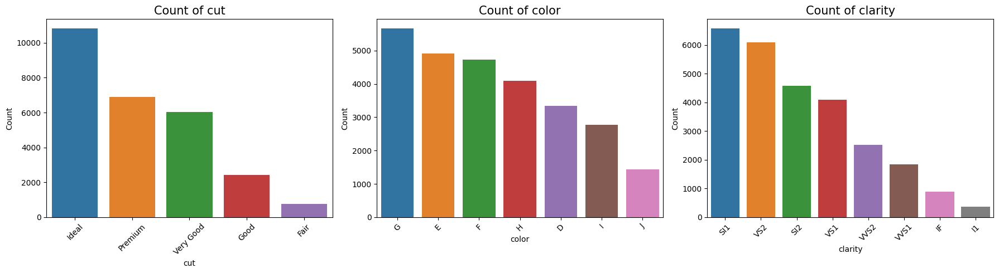

In [ ]:
# Plotting counts of categorical variables
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18, 5))
cat_vars = ['cut', 'color', 'clarity']
for i, var in enumerate(cat_vars):
    sns.countplot(data=data, x=var, order=data[var].value_counts().index, ax=axs[i])
    axs[i].set_title(f'Count of {var}', fontsize=15)
    axs[i].set_ylabel('Count')
    axs[i].set_xlabel(var)
    axs[i].tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()
# Quan sát thấy số lượng khác nhau ở mỗi loại, ở cả cut, color, và clarity

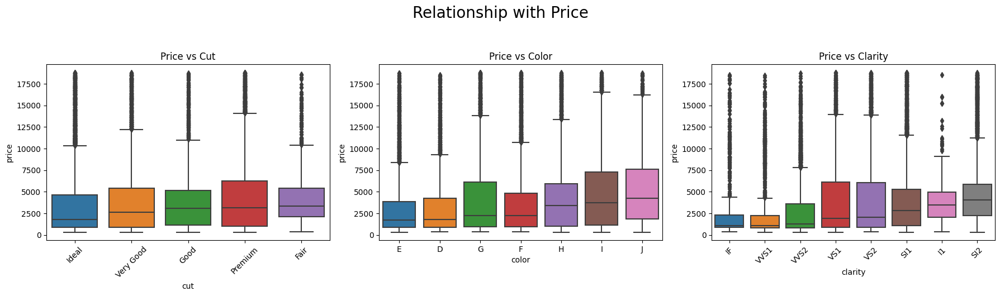

In [ ]:
# Visual Analysis: Relationship between various attributes and price

# Set up the figure and axes
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18, 5))
fig.suptitle('Relationship with Price', fontsize=20, y=1.05)

# Visualizing relationship of categorical variables with price
sns.boxplot(data=data, x='cut', y='price', ax=axs[0], order=data.groupby('cut')['price'].median().sort_values().index)
axs[0].set_title('Price vs Cut')
axs[0].tick_params(axis='x', rotation=45)

sns.boxplot(data=data, x='color', y='price', ax=axs[1], order=data.groupby('color')['price'].median().sort_values().index)
axs[1].set_title('Price vs Color')

sns.boxplot(data=data, x='clarity', y='price', ax=axs[2], order=data.groupby('clarity')['price'].median().sort_values().index)
axs[2].set_title('Price vs Clarity')
axs[2].tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
# Có sự khác biệt về giá với các Cut khác nhau, các Color khác nhau, các Clarity khác nhau

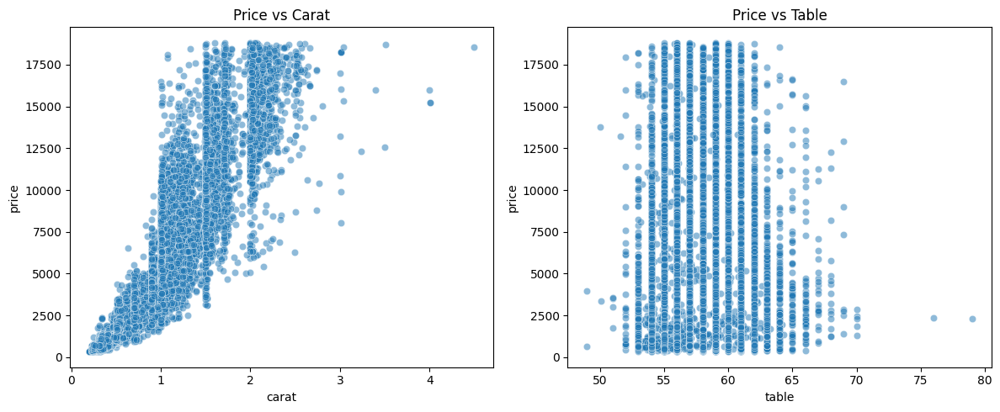

In [ ]:
# Visualizing relationship of numerical variables with price
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
sns.scatterplot(data=data, x='carat', y='price', ax=axs[0], alpha=0.5)
axs[0].set_title('Price vs Carat')

sns.scatterplot(data=data, x='table', y='price', ax=axs[1], alpha=0.5)
axs[1].set_title('Price vs Table')

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
# Có mối tương quan mạnh giữa Price và Carat, tương quan yêu giữa Price và Table

### Top 5 Insights from the Gemstone Dataset:
#### Weight is a Significant Factor

- The carat (weight) of the gemstone plays a pivotal role in determining its price. A clear positive correlation exists between the weight and the price of the gemstone. Generally, as gemstones increase in weight, they also rise in value. This observation aligns with the broader market understanding that larger gemstones tend to be more valuable.
#### Interrelation between Dimensions and Weight

- The gemstones' physical dimensions, represented by x, y, and z, show a strong correlation with their weight (carat). Essentially, as a gemstone's size increases, so does its weight, which is an anticipated relationship in the realm of gemstones.
#### Impact of Clarity and Color on Price

- Although the cut of a gemstone has an influence on its price, the variations in median prices are more pronounced for clarity and color. Specifically:
    - Gemstones graded with "IF" clarity fetch the highest median prices.
    - Conversely, gemstones graded with "I1" clarity have the lowest median prices.
    - In terms of color, gemstones graded as "J" have a higher median price compared to those graded as "E".
#### Outliers in the Dataset

- Potential outliers are present across several columns, notably in price, carat, and the dimensions (x, y, z). These outliers can have a significant impact on statistical evaluations and predictive modeling. Depending on the intended analysis or application, addressing these outliers might be crucial.
#### Depth's Limited Influence on Price

- The depth percentage of gemstones, which provides a measure of the gemstone's height relative to its width, doesn't exhibit a pronounced relationship with its price. While depth is an essential characteristic for aficionados and might influence properties like a gemstone's brilliance, its impact on price isn't strong in this dataset.


In [ ]:
# Kết luận: Chọn các thuộc tính nào để đưa vào build model?